<font size=25> Ti Tree Paleovalley Machine Learning</font>

# Imports

In [4]:
import xarray as xr
import geopandas as gpd
import numpy as np
import pandas as pd

import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow

from shapely.geometry import Point

import cartopy
import cartopy.crs as ccrs

import rasterio
from rasterio.plot import show
from rasterio import warp
import gdal
import affine
import pyproj
from osgeo import gdal

from skimage import exposure

from sklearn import preprocessing
from sklearn import svm
from sklearn.linear_model import LogisticRegression

import math
import pickle

from IPython.display import clear_output

# Load the Required Data

## Load the Study Area bounds
Save the bounding box so that other national data sources can be cropped to fit

I am densified (external_values, 14 elements)
studyarea_crs {'proj': 'longlat', 'ellps': 'GRS80', 'no_defs': True}
132.9598698750001 134.2741126830001 -23.054892064999933 -21.695553736999955


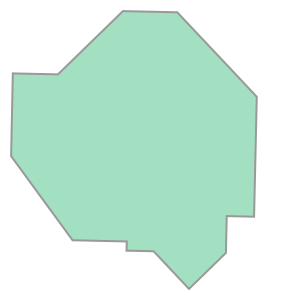

In [5]:
# load just the polygon for the Ti Tree Study Area
tt_studyarea = gpd.read_file('../GAData/EFTF_extents_March_2017.shp').to_crs({'init':'epsg:' + '3577'}).loc[5,'geometry']
tt_studyarea_latlon = gpd.read_file('../GAData/EFTF_extents_March_2017.shp').loc[5,'geometry']
studyarea_crs = gpd.read_file('../GAData/EFTF_extents_March_2017.shp').crs
print('studyarea_crs', studyarea_crs)
x, y = tt_studyarea_latlon.exterior.xy
# define the study area for cropping other datasets to
xmin, xmax = np.array(x).min(), np.array(x).max()
ymin, ymax = np.array(y).min(), np.array(y).max()
print(xmin, xmax, ymin, ymax)
tt_studyarea

## Open the National Geophysical Datasets, and crop to fit study area

In [6]:
def transformToAffine(transformstring):
    '''
    A quick helper function for datasets that only have a GDAL style GeoTransform, no Affine matrix.
    '''
    abcdef = transformstring.split()
    abcdef = [float(i) for i in abcdef]
    return affine.Affine.from_gdal(*abcdef)

In [4]:
# NCI file locations discovered from https://geonetwork.nci.org.au/geonetwork/srv/eng/catalog.search#/search
# the data layer name has been manually harvested for each
ngd_locs = {'mag': ['mag_tmi_rtp_anomaly', r'/g/data1/rr2/national_geophysical_compilations/magmap_v6_2015_VRTP/magmap_v6_2015_VRTP.nc'],
             'th': ['rad_th_equiv_conc', r'/g/data1/rr2/national_geophysical_compilations/radmap_v3_2015_filtered_ppmth/radmap_v3_2015_filtered_ppmth.nc'],
             'u': ['rad_u_equiv_conc', r'/g/data1/rr2/national_geophysical_compilations/radmap_v3_2015_filtered_ppmu/radmap_v3_2015_filtered_ppmu.nc'],
             'k': ['rad_k_conc', r'/g/data1/rr2/national_geophysical_compilations/radmap_v3_2015_filtered_pctk/radmap_v3_2015_filtered_pctk.nc'],
             'grav': ['grav_complete_boug_anomaly', r'/g/data1/rr2/national_geophysical_compilations/onshore_geodetic_Complete_Bouguer_2016/onshore_geodetic_Complete_Bouguer_2016.nc']}

data = {}
for key, [name, file] in ngd_locs.items():
    # open the file
    ds = xr.open_dataset(file)
    # combine the attributes from the crs dataarray with the overall attribs, and save for later
    attrs = {**ds.attrs, **ds.crs.attrs}
    # find the lat and lon of the top left corner of the study area bounding box
    tl = ds[name].sel(lon=xmin, method = 'nearest').sel(lat=ymax, method = 'nearest')
    # Find the lat and lon of the bottom right corner of the study area bounding box
    br = ds[name].sel(lon=xmax, method = 'nearest').sel(lat=ymin, method = 'nearest')
    # select the relevant data and save over the nationwide datavalues
    ds = ds[name].loc[tl.lat.values:br.lat.values,tl.lon.values:br.lon.values]
    # add the attribs to ds (which is really a DA at this point)
    ds.attrs = attrs
    # define the affine attribute based on the GeoTransform (affine are used throughout)
    ds.attrs['affine'] = transformToAffine(ds.attrs['GeoTransform'])
    # rename long and lat to x and y so these line up with all the other datasets that are UTM based
    ds = ds.rename({'lon':'x','lat':'y'})
    # save to a dict for future use
    data[key] = ds
    print(key, ds.shape)

mag (1, 1)
th (1, 1)
u (1, 1)
k (1, 1)
grav (1, 1)


## Load Raster Data

### Functions to Aid in Loading Rasters

In [5]:
def buildRasterAttributes(raster):
    '''
    A function that extracts the key aspects of a rasters profile and saves them to a dict
    '''
    attribs = {}
    attribs['count'] = raster.count
    attribs['width'] = raster.width
    attribs['height'] = raster.height
    attribs['bounds'] = raster.bounds
    attribs['transform'] = raster.transform
    attribs['affine'] = raster.affine
    attribs['crs'] = raster.crs
    attribs['nodata'] = raster.nodata
    return attribs

In [6]:
def buildAxesFromAttributes(attribs):
    '''
    Build numpy arrays for '''
    # build a numpy array of a range of the coordinates for a given set of attributes
    # set to np.float32 to save space
    xaxis = (np.arange(attribs['affine'][2],
                      attribs['affine'][2] + (attribs['affine'][0] * attribs['width']),
                      attribs['affine'][0])).astype(np.float32)
    yaxis = (np.arange(attribs['affine'][5],
                      attribs['affine'][5] + (attribs['affine'][4] * attribs['height']),
                      attribs['affine'][4])).astype(np.float32)
    return xaxis, yaxis

In [7]:
def rasterToXarray(fullpath, bandnames = None):
    '''
    A shortcut to building an Xarray from a single or multiband raster.
    Takes the full path of the raster as the primary parameter.
    If the raster is multi band, it takes a list of band names as the second parameter.
    If the raster is a single band, the function returns a dataarray.
    In the case of a multiband raster, the function returns a dataset
    ''' 
        
    with rasterio.open(fullpath, 'r') as src:
        # save the profile
        profile = buildRasterAttributes(src)
        # read the data, and set to np.float32 to save space    
        rasterdata = src.read().astype(np.float32)
        # boolean mask to change all "no data" values to np.nan
        rasterdata[rasterdata == profile['nodata']] = np.nan    
        # update the attributes to the new nodata value
        profile['nodata'] = np.nan    

        # build the coordinate lists
        x, y = buildAxesFromAttributes(profile)

        xarrays = []
        for i in range(rasterdata.shape[0]):
            xarrays.append(xr.DataArray(rasterdata[i], [('y', y), ('x', x)]))
            # set the attributes of the dataarray to the attributs of the parent raster
            xarrays[i].attrs = profile
        if len(xarrays) == 1:
            return xarrays[0]
        else:
            if bandnames == None:
                print('Please provide some bandnames for the multiband raster you are trying to open')
            elif len(bandnames) != len(xarrays):
                print('You have provided', len(bandnames), 'band names for the raster which has', len(xarrays), 'bands. Please rectify.')
                return
            else:
                ds = {bandnames[i] : xarrays[i] for i in range(rasterdata.shape[0])}
                ds = xr.Dataset(ds)
                ds.attrs = profile
                return ds

## Load Elevation Data

In [8]:
# define where the DEM data lives
dem_dir = '/g/data1a/zk34/mb4539/ssc/GAData/'
# define the DEM files to be opened
dem_files = {'elevation':'tt_dem_500m.tif', 'aspect': 'tt_aspect_500m.tif', 'slope': 'tt_slope_500m.tif'}
dem_paths = {name : dem_dir + file for name, file in dem_files.items()}

# dem_paths
for name, file in dem_paths.items():
    data[name] = rasterToXarray(file)
data.keys()

/g/data/v10/public/modules/dea-env/20180405/lib/python3.6/site-packages/ipykernel_launcher.py:12: RasterioDeprecationWarning: 'src.affine' is deprecated.  Please switch to 'src.transform'. See https://github.com/mapbox/rasterio/issues/86 for details.
  if sys.path[0] == '':
/g/data/v10/public/modules/dea-env/20180405/lib/python3.6/site-packages/ipykernel_launcher.py:12: RasterioDeprecationWarning: 'src.affine' is deprecated.  Please switch to 'src.transform'. See https://github.com/mapbox/rasterio/issues/86 for details.
  if sys.path[0] == '':
/g/data/v10/public/modules/dea-env/20180405/lib/python3.6/site-packages/ipykernel_launcher.py:12: RasterioDeprecationWarning: 'src.affine' is deprecated.  Please switch to 'src.transform'. See https://github.com/mapbox/rasterio/issues/86 for details.
  if sys.path[0] == '':


dict_keys(['mag', 'th', 'u', 'k', 'grav', 'elevation', 'aspect', 'slope'])

## Load DEA Geomedian

In [9]:
data['landsat'] = rasterToXarray('/g/data1a/zk34/mb4539/ssc/GAData/2017geomed.tif', ['blue','green','red','nir','swir1','swir2'])
print(data.keys())
data['landsat']

/g/data/v10/public/modules/dea-env/20180405/lib/python3.6/site-packages/ipykernel_launcher.py:12: RasterioDeprecationWarning: 'src.affine' is deprecated.  Please switch to 'src.transform'. See https://github.com/mapbox/rasterio/issues/86 for details.
  if sys.path[0] == '':


dict_keys(['mag', 'th', 'u', 'k', 'grav', 'elevation', 'aspect', 'slope', 'landsat'])


<xarray.Dataset>
Dimensions:  (x: 5444, y: 6142)
Coordinates:
  * y        (y) float32 -2333350.0 -2333375.0 -2333400.0 -2333425.0 ...
  * x        (x) float32 97425.0 97450.0 97475.0 97500.0 97525.0 97550.0 ...
Data variables:
    blue     (y, x) float32 nan nan nan nan nan nan nan nan nan nan nan nan ...
    green    (y, x) float32 nan nan nan nan nan nan nan nan nan nan nan nan ...
    red      (y, x) float32 nan nan nan nan nan nan nan nan nan nan nan nan ...
    nir      (y, x) float32 nan nan nan nan nan nan nan nan nan nan nan nan ...
    swir1    (y, x) float32 nan nan nan nan nan nan nan nan nan nan nan nan ...
    swir2    (y, x) float32 nan nan nan nan nan nan nan nan nan nan nan nan ...
Attributes:
    count:      6
    width:      5444
    height:     6142
    bounds:     BoundingBox(left=97425.0, bottom=-2486900.0, right=233525.0, ...
    transform:  | 25.00, 0.00, 97425.00|\n| 0.00,-25.00,-2333350.00|\n| 0.00,...
    affine:     | 25.00, 0.00, 97425.00|\n| 0.00,-25.00,-2

## Load AEM Data

In [10]:
data['aem'] = pd.read_csv('../GAData/TT_AEM_with_allPVDepth.csv')
# # make a geometry column with shapely points
data['aem']['geometry'] = data['aem'].apply(lambda x: Point((float(x.easting), float(x.northing))), axis=1)
# # change to a geodataframe
data['aem'] = gpd.GeoDataFrame(data['aem'], crs = {'init': 'espg:28353'}, geometry = 'geometry')
if 'espg' in data['aem'].crs['init']:
    data['aem'].crs['init'] = data['aem'].crs['init'].replace('espg','epsg')

# # newx, newy = pyproj.transform(pyproj.Proj(init='epsg:28353'),
# #                               coords_proj,
# #                               data['aem']['easting'].values,
# #                               data['aem']['easting'].values)
# # data['aem']['newx'] = newx
# # data['aem']['newy'] = newy
print(data['aem'].crs)
data['aem'][data['aem']['depth_to_basement'].notnull()]

{'init': 'epsg:28353'}
I am densified (60 elements)
I am densified (60 elements)


,Unnamed: 0,sequence,line,easting,northing,elevation,DataResidual,Residual2,Residual3,TotalResidual,...,24_depth_top,25_depth_top,26_depth_top,27_depth_top,28_depth_top,29_depth_top,30_depth_top,dist_from_point,depth_to_basement,geometry
11116,165850,9868,118251,320023.2,7557958.0,561.71,5.248,0.0,0.862,0.623,...,204.67,237.55,275.7,319.96,371.31,430.88,500.0,44962.601912,530.000000,POINT (320023.2 7557958)
11117,165851,9869,118251,320012.8,7557944.0,561.56,5.669,0.0,1.049,0.743,...,204.67,237.55,275.7,319.96,371.31,430.88,500.0,44980.042042,530.000000,POINT (320012.8 7557944)
11118,165852,9870,118251,320002.4,7557930.0,561.39,10.632,0.0,0.115,0.397,...,204.67,237.55,275.7,319.96,371.31,430.88,500.0,44997.482171,530.000000,POINT (320002.4 7557930)
11119,165853,9871,118251,319991.9,7557916.0,561.24,6.091,0.0,1.121,0.803,...,204.67,237.55,275.7,319.96,371.31,430.88,500.0,45014.982133,530.000000,POINT (319991.9 7557916)
11120,165854,9872,118251,319981.5,7557902.0,561.14,7.159,0.0,0.242,0.362,...,204.67,237.55,275.7,319.96,371.31,430.88,500.0,45032.422262,530.000000,POINT (319981.5 7557902)
11121,165855,9873,118251,319971.4,7557888.0,561.03,5.840,0.0,0.819,0.618,...,204.67,237.55,275.7,319.96,371.31,430.88,500.0,45049.682896,530.000000,POINT (319971.4 7557888)
11122,165856,9874,118251,319961.7,7557875.0,560.89,6.057,0.0,0.667,0.534,...,204.67,237.55,275.7,319.96,371.31,430.88,500.0,45065.902945,530.000000,POINT (319961.7 7557875)
11123,165857,9875,118251,319952.2,7557861.0,560.68,10.492,0.0,0.119,0.404,...,204.67,237.55,275.7,319.96,371.31,430.88,500.0,45082.804597,530.000000,POINT (319952.2 7557861)
11124,165858,9876,118251,319942.7,7557848.0,560.42,9.818,0.0,0.120,0.394,...,204.67,237.55,275.7,319.96,371.31,430.88,500.0,45098.904985,530.000000,POINT (319942.7 7557848)
11125,165859,9877,118251,319932.7,7557834.0,560.17,6.058,0.0,0.478,0.442,...,204.67,237.55,275.7,319.96,371.31,430.88,500.0,45116.105797,530.000000,POINT (319932.7 7557834)


# Coordinate Systems Definitions

In [11]:
# epsg = {'gda94_geog' = pyproj.Proj(init='epsg:4283'),       # GDA 94 geographic coordinates (national geophysics grids)
#         'wgs84_utm53S' = pyproj.Proj(init='epsg:28353'),    # WGS zone 53 south projected coords (slope grids)
#         'gda94_albers_53S' = pyproj.Proj(init='epsg:3577')} # GDA94 Albers zone 53 South projected coords (landsat)

studyarea_epsg = '4326'                   # WGS84 Geographic LatLong
data_epsgcodes = {'grav':'4283',          # GDA94 Geographic LatLong
                    'mag':'4283',
                    'k':'4283',
                    'u':'4283',
                    'th':'4283',
                    'landsat':'3577',     # GDA94 Albers zone 53 South projected coords (landsat)
                    'elevation':'28353',  # WGS zone 53 south projected coords 
                    'slope':'28353',
                    'aspect':'28353',
                     'aem': '28353'}

for dtype, epsg in data_epsgcodes.items():
    try: 
        data[dtype].attrs['epsg'] = data_epsgcodes[dtype]
        print(dtype, 'done')
    except:
        print(dtype, "failed")
        continue


grav done
mag done
k done
u done
th done
landsat done
elevation done
slope done
aspect done
aem failed


In [14]:
xmin

97965.52893941206

# Setup the Interpolation Grid

In [16]:
# create the grid to be interpolated

# find the top left corner of the study area in AEA, same for bottom right.
trainingdata_crs = pyproj.Proj(init='epsg:3577')
studyarea_proj = pyproj.Proj(init= 'epsg:' + studyarea_epsg)
tlx, tly = pyproj.transform(studyarea_proj,trainingdata_crs, xmin, ymax)
brx, bry = pyproj.transform(studyarea_proj,trainingdata_crs, xmax, ymin)


# tlx, brx,tly,  bry = 150000, 160000, -2395000, -2400000
cellsize = 500
xrange = range(int(tlx), int(brx) + cellsize, cellsize)
yrange = range(int(bry), int(tly) + cellsize, cellsize)

# meshgrid, or just make a list
xcol = []
ycol = []
for ycell in yrange:
    for xcell in xrange:
        xcol.append(xcell)
        ycol.append(ycell)
        
trainingdata = pd.DataFrame(columns = data.keys())
trainingdata['x'] = xcol
trainingdata['y'] = ycol
del xcol, ycol
trainingdata['PV'] = np.nan
# trainingdata = trainingdata.drop(labels = ['aem', 'landsat'], axis = 1)
landsatbands = list(data['landsat'].data_vars)
for band in landsatbands:
    trainingdata[band] = np.nan
# to save memory and deal with object type nan, as opposed to float NaN
trainingdata = trainingdata.astype(np.float32)

trainingdata['geometry'] = trainingdata.apply(lambda row: Point((float(row.x), float(row.y))), axis=1)
# change to a geodataframe
trainingdata = gpd.GeoDataFrame(trainingdata, geometry = 'geometry')
# assign the CRS, GDA94 Albers Equal Area
trainingdata.crs = {'init': 'epsg:3577'}
trainingdata

I am densified (60 elements)
I am densified (60 elements)


,mag,th,u,k,grav,elevation,aspect,slope,landsat,aem,x,y,PV,blue,green,red,nir,swir1,swir2,geometry
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,98567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (98567 -2486883)
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,99067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (99067 -2486883)
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,99567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (99567 -2486883)
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (100067 -2486883)
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (100567 -2486883)
5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,101067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (101067 -2486883)
6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,101567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (101567 -2486883)
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,102067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (102067 -2486883)
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,102567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (102567 -2486883)
9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,103067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (103067 -2486883)


# Populate The Grid

## Original Functions

In [ ]:
# find range of coordinates for cell
def getPVBoolean(coords, coords_proj, cellsize):
    # create a projection object for the dataarray being queried
    data_crs = pyproj.Proj(init=data['aem'].crs['init'])
    # convert the incoming query coordinates to the new CRS
    newcrs_x, newcrs_y = pyproj.transform(coords_proj, data_crs, coords[0],coords[1])
    
    # need to deal with cell size not in metres (eg decimal degrees)
    # do this by adding the cell size to the input coordinates
    # run this through the projection transform
    # and calculate the difference betwee this dummy coordinate pair and the ones being queried
    dummy_x, dummy_y = coords[0] + cellsize, coords[1] + cellsize
    newcrs_dummy_x, newcrs_dummy_y = pyproj.transform(coords_proj, data_crs, dummy_x, dummy_y)
    transformed_gridsize = round(abs(newcrs_dummy_x - newcrs_x),3)
    # select the fiducials that are within the pixel area
    fids = data['aem'][(data['aem']['easting'] >= newcrs_x - (transformed_gridsize/2)) &
                (data['aem']['easting'] <= newcrs_x + (transformed_gridsize/2)) &
                (data['aem']['northing'] >= newcrs_y - (transformed_gridsize/2)) &
                (data['aem']['northing'] <= newcrs_y + (transformed_gridsize/2))]
    # if any depth to basements are not null, ie there is paleo valley in this pixel, return 1, else 0
    if len(fids) == 0:
        return np.nan
    elif fids['depth_to_basement'].notnull().any():
        return 1
    else:
        return 0

In [20]:
def getDataValue(datatype, coords, coords_proj, cellsize):
    '''
    This function takes the X and Y of the cell being populated in the training/predicted grid
    along with the datatype it want to populate, the coordinates of the training grid and the
    cell size of the existing grid.
    
    It converts the coordinates to the coordinates of the trainig cell into the crs of the known data.
    It then queries the dataarray, and pulls either just the corresponding cell value or an average of
    several cells dpending on the relative gridcell sizes.
    
    It returns this value back to the caller.
    '''

    # create a projection object for the dataarray being queried
    data_crs = pyproj.Proj(init='epsg:' + data[datatype].attrs['epsg'])
    # convert the incoming query coordinates to the new CRS
    newcrs_x, newcrs_y = pyproj.transform(coords_proj, data_crs, coords[0],coords[1])
    
    # need to deal with cell size not in metres (eg decimal degrees)
    # do this by adding the cell size to the input coordinates
    # run this through the projection transform
    # and calculate the difference betwee this dummy coordinate pair and the ones being queried
    dummy_x, dummy_y = coords[0] + cellsize, coords[1] + cellsize
    newcrs_dummy_x, newcrs_dummy_y = pyproj.transform(coords_proj, data_crs, dummy_x, dummy_y)
    transformed_gridsize = round(abs(newcrs_dummy_x - newcrs_x),3)
#     print(newcrs_x, newcrs_y, transformed_gridsize)
    # if the cell size for the array being created is smaller than that of the data,
    # find the single cell that best aligns with the cell to be populated
    if data[datatype].attrs['affine'][0] >= transformed_gridsize:
        return data[datatype].sel(x = newcrs_x, y = newcrs_y, method = 'nearest').values
    # if the new grid is coarser than the existing one, serach over the range +/- a pixel
    # and return the mean of all the values collected.
    # not good for slope or aspect
    else:
        return np.nanmean(data[datatype].sel(x=slice(newcrs_x-(transformed_gridsize/2),
                                   newcrs_x + (transformed_gridsize/2)),
                                   y = slice(newcrs_y - (transformed_gridsize/2),
                                             newcrs_y + (transformed_gridsize/2))).values)

In [21]:
def getLandsatValue(band, coords, coords_proj, cellsize):
    '''

    '''

    # create a projection object for the dataarray being queried
    data_crs = pyproj.Proj(init='epsg:' + data['landsat'].attrs['epsg'])
    # convert the incoming query coordinates to the new CRS
    newcrs_x, newcrs_y = pyproj.transform(coords_proj, data_crs, coords[0],coords[1])
    
    # need to deal with cell size not in metres (eg decimal degrees)
    # do this by adding the cell size to the input coordinates
    # run this through the projection transform
    # and calculate the difference betwee this dummy coordinate pair and the ones being queried
    dummy_x, dummy_y = coords[0] + cellsize, coords[1] + cellsize
    newcrs_dummy_x, newcrs_dummy_y = pyproj.transform(coords_proj, data_crs, dummy_x, dummy_y)
    transformed_gridsize = round(abs(newcrs_dummy_x - newcrs_x),3)
#     print(newcrs_x, newcrs_y, transformed_gridsize)
    # if the cell size for the array being created is smaller than that of the data,
    # find the single cell that best aligns with the cell to be populated
    if data['landsat'][band].attrs['affine'][0] >= transformed_gridsize:
        return data['landsat'][band].sel(x = newcrs_x, y = newcrs_y, method = 'nearest').values
    # if the new grid is coarser than the existing one, serach over the range +/- a pixel
    # and return the mean of all the values collected.
    # not good for slope or aspect
    else:
        return data['landsat'][band].sel(x=slice(newcrs_x-(transformed_gridsize/2),
                                   newcrs_x + (transformed_gridsize/2)),
                                   y = slice(newcrs_y + (transformed_gridsize/2),
                                             newcrs_y - (transformed_gridsize/2))).values.mean()

### Running Original (Nested Loop Version)

In [18]:
import datetime
start = datetime.datetime.now()

# only do the easy ones to start
easy_data = [key for key in data.keys() if key not in ['aem','landsat']]

# get the column numbers
xcol_num, ycol_num = trainingdata.columns.get_loc('x'), trainingdata.columns.get_loc('y')

# for each row
for row in range(len(trainingdata)):
    # save the coords
    train_coords = trainingdata.iloc[row, [xcol_num, ycol_num]]
    # for each datatype, get the data for that pair of coords
    pvcol_num = trainingdata.columns.get_loc('PV')
    
    # populate the presence of absence of known PV based on AEM interp
    trainingdata.iloc[row, pvcol_num] = getPVBoolean(train_coords, trainingdata_crs, cellsize)
    
    # populate the easy raster based datasets
    for dtype in easy_data:
        dtype_num = trainingdata.columns.get_loc(dtype)
        trainingdata.iloc[row, dtype_num] = getDataValue(dtype, train_coords, trainingdata_crs, cellsize)
    
    # populate the landsat image data
    for band in landsatbands:
        dtype_num = trainingdata.columns.get_loc(band)
        trainingdata.iloc[row, dtype_num] = getLandsatValue(band, train_coords, trainingdata_crs, cellsize)
print("Process took:", datetime.datetime.now() - start)
trainingdata

/g/data/v10/public/modules/dea-env/20180405/lib/python3.6/site-packages/ipykernel_launcher.py:38: RuntimeWarning: Mean of empty slice
/g/data/v10/public/modules/dea-env/20180405/lib/python3.6/site-packages/ipykernel_launcher.py:30: RuntimeWarning: Mean of empty slice.
/g/data/v10/public/modules/dea-env/20180405/lib/python3.6/site-packages/numpy/core/_methods.py:80: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


Process took: 0:46:40.400980


,mag,th,u,k,grav,elevation,aspect,slope,x,y,PV,blue,green,red,nir,swir1,swir2
0,NaN,NaN,NaN,NaN,302.114929,NaN,NaN,NaN,98567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,303.035400,NaN,NaN,NaN,99067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,303.035400,NaN,NaN,NaN,99567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,304.281708,NaN,NaN,NaN,100067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,304.281708,NaN,NaN,NaN,100567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,NaN,NaN,304.865906,NaN,NaN,NaN,101067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN,304.787537,NaN,NaN,NaN,101567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN,304.787537,NaN,NaN,NaN,102067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,NaN,NaN,NaN,NaN,304.426331,NaN,NaN,NaN,102567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,NaN,304.426331,NaN,NaN,NaN,103067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Vectorized Versions

In [13]:
def getSinglePixelData(row, dtype):
    x, y = row['geometry'].coords[0]
    return data[dtype].sel(x = x, y = y, method = 'nearest').values

def getMultiPixelMean(row, dtype, transformed_gridsize):
    x, y = row['geometry'].coords[0]
    return np.nanmean(data[dtype].sel(x=slice(x-(transformed_gridsize/2),
                                   x + (transformed_gridsize/2)),
                                   y = slice(y + (transformed_gridsize/2),
                                             y - (transformed_gridsize/2))).values)  
def getMultiPixelMeanLandsat(row, band, transformed_gridsize):
    x, y = row['geometry'].coords[0]
    return np.nanmean(data['landsat'][band].sel(x=slice(x-(transformed_gridsize/2),
                                   x + (transformed_gridsize/2)),
                                   y = slice(y + (transformed_gridsize/2),
                                             y - (transformed_gridsize/2))).values)

easy_data = [key for key in data.keys() if key not in ['aem','landsat']]

geom_col = trainingdata.columns.get_loc('geometry')    

# populate the landsat data
trainingdata = trainingdata.to_crs({'init': 'epsg:'+ data['landsat'].attrs['epsg']})
transformed_gridsize = abs(round(trainingdata.iloc[0,geom_col].coords[0][0] - trainingdata.iloc[1,geom_col].coords[0][0],3))
for band in landsatbands:
    # assume landsat pixels are always smaller than trainingdata grid size
    trainingdata[band] = trainingdata.apply(lambda row: getMultiPixelMeanLandsat(row, band, transformed_gridsize), axis = 1)
    print(band, 'done')

# populate the other raster data    
for dtype in easy_data:
    trainingdata = trainingdata.to_crs({'init': 'epsg:'+ data[dtype].attrs['epsg']})
    transformed_gridsize = abs(round(trainingdata.iloc[0,geom_col].coords[0][0] - trainingdata.iloc[1,geom_col].coords[0][0],3))
    if data[dtype].attrs['affine'][0] >= transformed_gridsize:
        trainingdata[dtype] = trainingdata.apply(lambda row: getSinglePixelData(row, dtype), axis = 1)
    else:
        trainingdata[dtype] = trainingdata.apply(lambda row: getMultiPixelMean(row, dtype, transformed_gridsize), axis = 1)
    print(dtype, 'done')

I am densified (external_values, 82194 elements)


/g/data/v10/public/modules/dea-env/20180405/lib/python3.6/site-packages/ipykernel_launcher.py:16: RuntimeWarning: Mean of empty slice
  app.launch_new_instance()


blue done
green done
red done
nir done
swir1 done
swir2 done
I am densified (external_values, 82194 elements)


/g/data/v10/public/modules/dea-env/20180405/lib/python3.6/site-packages/ipykernel_launcher.py:10: RuntimeWarning: Mean of empty slice
  # Remove the CWD from sys.path while we load stuff.


mag done
I am densified (external_values, 82194 elements)
th done
I am densified (external_values, 82194 elements)
u done
I am densified (external_values, 82194 elements)
k done
I am densified (external_values, 82194 elements)
grav done
I am densified (external_values, 82194 elements)
elevation done
I am densified (external_values, 82194 elements)
aspect done
I am densified (external_values, 82194 elements)
slope done


In [14]:
def getPVBooleanVector(row, transformed_gridsize):
    x, y = row['geometry'].coords[0]
    fids = data['aem'][(data['aem']['easting'] >= x - (transformed_gridsize/2)) &
                (data['aem']['easting'] <= x + (transformed_gridsize/2)) &
                (data['aem']['northing'] >= y - (transformed_gridsize/2)) &
                (data['aem']['northing'] <= y + (transformed_gridsize/2))]
    # if any depth to basements are not null, ie there is paleo valley in this pixel, return 1, else 0
    # first, if there are no fiducials in the pixel, leave pixel as NaN
    if len(fids) == 0:
        return np.nan
    fidlines = fids['line'].unique()
    for line in fidlines:
        if data['aem'][data['aem']['line'] == line]['depth_to_basement'].isna().all():
            idx_todrop = fids[fids['line'] == line].index
            fids = fids.drop(index = idx_todrop)
    if len(fids) == 0:
        return np.nan
    elif fids['depth_to_basement'].notnull().any():
        return 1
    else:
        return 0

# populate the PV picks data
trainingdata = trainingdata.to_crs(data['aem'].crs)
transformed_gridsize = abs(round(trainingdata.iloc[0,geom_col].coords[0][0] - trainingdata.iloc[1,geom_col].coords[0][0],3))
trainingdata['PV'] = trainingdata.apply(lambda row: getPVBooleanVector(row, transformed_gridsize), axis = 1)

trainingdata

I am densified (external_values, 82194 elements)
I am densified (60 elements)
I am densified (60 elements)


,mag,th,u,k,grav,elevation,aspect,slope,x,y,PV,blue,green,red,nir,swir1,swir2,geometry
0,NaN,NaN,NaN,NaN,302.11492919921875,NaN,NaN,NaN,98567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (292165.4360497537 7447298.899982017)
1,NaN,NaN,NaN,NaN,303.035400390625,NaN,NaN,NaN,99067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (292670.2247143259 7447309.673471373)
2,NaN,NaN,NaN,NaN,303.035400390625,NaN,NaN,NaN,99567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (293175.0120027785 7447320.448991105)
3,NaN,NaN,NaN,NaN,304.2817077636719,NaN,NaN,NaN,100067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (293679.7979181532 7447331.226541365)
4,NaN,NaN,NaN,NaN,304.2817077636719,NaN,NaN,NaN,100567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (294184.5824634887 7447342.006122282)
5,NaN,NaN,NaN,NaN,304.86590576171875,NaN,NaN,NaN,101067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (294689.3656418184 7447352.787734028)
6,NaN,NaN,NaN,NaN,304.78753662109375,NaN,NaN,NaN,101567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (295194.1474561813 7447363.571376732)
7,NaN,NaN,NaN,NaN,304.78753662109375,NaN,NaN,NaN,102067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (295698.9279096134 7447374.357050544)
8,NaN,NaN,NaN,NaN,304.42633056640625,NaN,NaN,NaN,102567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (296203.707005153 7447385.144755617)
9,NaN,NaN,NaN,NaN,304.42633056640625,NaN,NaN,NaN,103067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (296708.4847458313 7447395.934492087)


In [16]:
trainingdata = trainingdata[trainingdata.columns[0:-1]].astype(np.float32)
for col in trainingdata.columns:
    print(col, len(trainingdata[trainingdata[col].notnull()]))

mag 81119
th 81069
u 81069
k 81069
grav 82194
elevation 56130
aspect 56130
slope 56130
x 82194
y 82194
PV 3307
blue 56560
green 56560
red 56560
nir 56560
swir1 56560
swir2 56560


### Deal with Aspect as a circlular quantity

In [17]:
# need to deal with slope/aspect - regrid and use pydem?
# need to use sin and cos of aspect because of the circular nature of it
# (ie 359 and 001 are as close as 90 and 92)
trainingdata['aspect_sin'] = np.sin(trainingdata['aspect'] * (np.pi / 180))
trainingdata['aspect_cos'] = np.cos(trainingdata['aspect'] * (np.pi / 180))
# this column not needed now
trainingdata = trainingdata.drop(['aspect'], axis = 1)

In [18]:
trainingdata

,mag,th,u,k,grav,elevation,slope,x,y,PV,blue,green,red,nir,swir1,swir2,aspect_sin,aspect_cos
0,NaN,NaN,NaN,NaN,302.114929,NaN,NaN,98567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,303.035400,NaN,NaN,99067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,303.035400,NaN,NaN,99567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,304.281708,NaN,NaN,100067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,304.281708,NaN,NaN,100567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,NaN,NaN,304.865906,NaN,NaN,101067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN,304.787537,NaN,NaN,101567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN,304.787537,NaN,NaN,102067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,NaN,NaN,NaN,NaN,304.426331,NaN,NaN,102567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,NaN,304.426331,NaN,NaN,103067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [83]:
trainingdata.to_csv('TT_PV_alldata.csv')

# SVC Machine Learning Stuff

## SVC

### Scale, Normalize, Fit

In [57]:
# build a list of columns/feautres to use for the classification process
train_features = [col for col in trainingdata.columns if col not in ['PV']]
print(train_features)
# subset the data to non-null rows
train_ss = trainingdata[trainingdata['PV'].notnull()].dropna(axis = 0, how = 'any', subset = train_features)
# 
train_x = train_ss[train_features].values
train_y = train_ss['PV'].values
train_ss


scaler = preprocessing.StandardScaler().fit(train_x)
train_x = scaler.transform(train_x)
train_x = preprocessing.normalize(train_x)

clf = svm.SVC()
clf.fit(train_x,train_y)


['mag', 'th', 'u', 'k', 'grav', 'elevation', 'slope', 'x', 'y', 'blue', 'green', 'red', 'nir', 'swir1', 'swir2', 'aspect_sin', 'aspect_cos']


SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto', kernel='rbf',
  max_iter=-1, probability=False, random_state=None, shrinking=True,
  tol=0.001, verbose=False)

### Predict

In [58]:
predict_ss = trainingdata[trainingdata['PV'].isnull()].dropna(axis = 0, how = 'any', subset = train_features)[train_features]
predict_ss_vals = predict_ss.values

# scale and normalize the data so it resembles the training data.
predict_ss_vals = scaler.transform(predict_ss_vals)
predict_ss_vals = preprocessing.normalize(predict_ss_vals)

# results of predict() are a 1 dimensional numpy array of the same length as the input data
# assign these results to a new column in the dataframe
predict_ss['PV_predicted'] = clf.predict(predict_ss_vals)
predict_ss

,mag,th,u,k,grav,elevation,slope,x,y,blue,green,red,nir,swir1,swir2,aspect_sin,aspect_cos,PV_predicted
991,-193.589111,21.953676,1.263546,1.902893,-369.417053,737.843628,0.413649,195067.0,-2485383.0,639.780884,1108.934448,1720.901733,2845.682617,3110.403076,2306.390381,-0.833546,0.552450,0.0
992,-359.756958,24.069424,1.280366,1.972535,-370.281891,741.561035,0.447116,195567.0,-2485383.0,631.734985,1086.252441,1680.750000,2797.147461,3022.370117,2242.524902,-0.791115,0.611668,0.0
1256,-34.025799,23.300398,1.326683,1.956514,-365.594757,732.037292,0.477001,194567.0,-2484883.0,631.046143,1109.861572,1761.138428,2825.523193,3135.117920,2397.325684,-0.939953,0.341304,0.0
1257,-153.509460,24.523447,1.196292,2.058306,-367.362579,735.901062,0.705698,195067.0,-2484883.0,634.539978,1109.989990,1724.314941,2857.977539,3106.152588,2317.929932,-0.780398,0.625284,0.0
1258,-217.923676,28.122620,2.378444,1.931889,-368.724213,738.394287,0.624086,195567.0,-2484883.0,638.650024,1106.805054,1752.152466,2837.300049,3127.995117,2330.949951,-0.861310,0.508079,0.0
1259,-249.833466,31.918865,2.843747,1.755787,-368.724213,742.615051,0.504858,196067.0,-2484883.0,549.395020,953.747498,1558.545044,2558.312500,2980.907471,2237.415039,-0.966473,0.256767,0.0
1521,68.795990,23.239252,1.430742,1.813098,-365.594757,728.641602,0.630333,194067.0,-2484383.0,608.789612,1084.724731,1777.176636,2853.815674,3259.267578,2507.446777,-0.680979,0.732303,0.0
1522,113.422783,25.276352,1.665136,1.996420,-365.594757,732.879883,0.705930,194567.0,-2484383.0,573.507507,1032.187500,1700.542480,2787.979980,3183.912598,2442.879883,-0.742124,0.670262,0.0
1523,15.675154,30.336990,2.794162,1.848984,-367.362579,733.042053,0.707005,195067.0,-2484383.0,571.405029,1003.174988,1617.104980,2699.125000,3012.739990,2264.909912,-0.984220,0.176951,0.0
1524,38.608364,36.884537,3.264507,1.571881,-368.724213,736.534912,0.897206,195567.0,-2484383.0,472.112488,809.697510,1306.410034,2155.199951,2619.979980,2013.560059,-0.967620,-0.252411,0.0


In [59]:
PV = predict_ss[['x','y','PV_predicted']].append(train_ss[['x','y','PV']])
PV.loc[PV['PV'].isna().index,'PV'] = PV[PV['PV'].isna()]['PV_predicted']
PV = PV.drop(labels = 'PV_predicted', axis = 1)
PV

,PV,x,y
991,0.0,195067.0,-2485383.0
992,0.0,195567.0,-2485383.0
1256,0.0,194567.0,-2484883.0
1257,0.0,195067.0,-2484883.0
1258,0.0,195567.0,-2484883.0
1259,0.0,196067.0,-2484883.0
1521,0.0,194067.0,-2484383.0
1522,0.0,194567.0,-2484383.0
1523,0.0,195067.0,-2484383.0
1524,0.0,195567.0,-2484383.0


### View Results

In [60]:
results = PV.combine_first(trainingdata[['PV','x','y']])
x = results['x'].values.reshape(len(yrange), len(xrange))[0,:]
y = results['y'].values.reshape(len(yrange), len(xrange))[:,0]
results = results['PV'].values.reshape(len(yrange), len(xrange))
results = xr.DataArray(results, coords = [y,x], dims = ['y','x'])

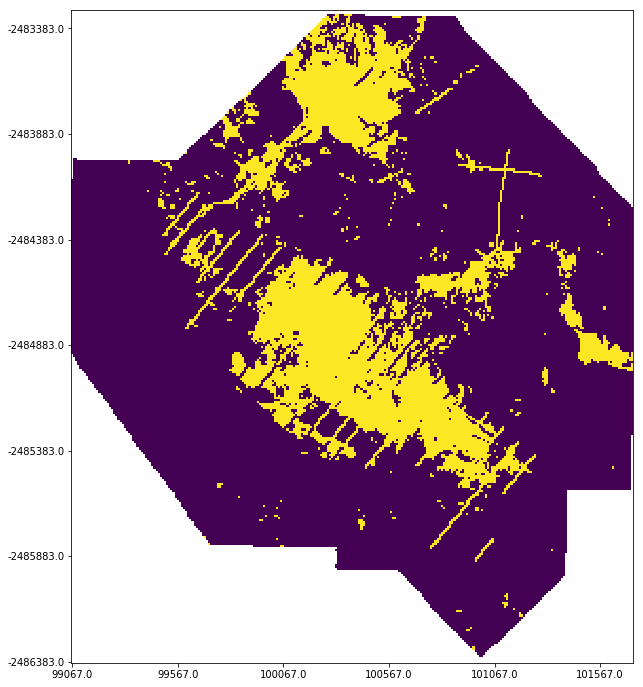

In [75]:
plt.figure(figsize=[12,12])
imshow(results)
ax = plt.gca()
ax.set_xticklabels(results.x.values)
ax.set_yticklabels(results.y.values)
ax.invert_yaxis()
# ax.plot(x, y)

# Logistic Regression

## Load the Aggregated Data, if needed

In [17]:
# load the data
trainingdata = pd.read_csv('TT_PV_alldata.csv').drop(labels = 'Unnamed: 0', axis =1)
xrange = range(98567, 231312, 500)
yrange = range(-2486883, -2332859, 500)

for col in trainingdata.columns:
    print(col, len(trainingdata[trainingdata[col].notna()]))
trainingdata

mag 81119
th 81069
u 81069
k 81069
grav 82194
elevation 56130
slope 56130
x 82194
y 82194
PV 3307
blue 56560
green 56560
red 56560
nir 56560
swir1 56560
swir2 56560
aspect_sin 56130
aspect_cos 56130


,mag,th,u,k,grav,elevation,slope,x,y,PV,blue,green,red,nir,swir1,swir2,aspect_sin,aspect_cos
0,NaN,NaN,NaN,NaN,302.11493,NaN,NaN,98567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,303.03540,NaN,NaN,99067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,303.03540,NaN,NaN,99567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,304.28170,NaN,NaN,100067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,304.28170,NaN,NaN,100567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,NaN,NaN,304.86590,NaN,NaN,101067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN,304.78754,NaN,NaN,101567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN,304.78754,NaN,NaN,102067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,NaN,NaN,NaN,NaN,304.42633,NaN,NaN,102567.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,NaN,304.42633,NaN,NaN,103067.0,-2486883.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [21]:
data = {key: value for key, value in data.items() if key in ['landsat']}
data

{'landsat': <xarray.Dataset>
 Dimensions:  (x: 5444, y: 6142)
 Coordinates:
   * y        (y) float32 -2333350.0 -2333375.0 -2333400.0 -2333425.0 ...
   * x        (x) float32 97425.0 97450.0 97475.0 97500.0 97525.0 97550.0 ...
 Data variables:
     blue     (y, x) float32 nan nan nan nan nan nan nan nan nan nan nan nan ...
     green    (y, x) float32 nan nan nan nan nan nan nan nan nan nan nan nan ...
     red      (y, x) float32 nan nan nan nan nan nan nan nan nan nan nan nan ...
     nir      (y, x) float32 nan nan nan nan nan nan nan nan nan nan nan nan ...
     swir1    (y, x) float32 nan nan nan nan nan nan nan nan nan nan nan nan ...
     swir2    (y, x) float32 nan nan nan nan nan nan nan nan nan nan nan nan ...
 Attributes:
     count:      6
     width:      5444
     height:     6142
     bounds:     BoundingBox(left=97425.0, bottom=-2486900.0, right=233525.0, ...
     transform:  | 25.00, 0.00, 97425.00|\n| 0.00,-25.00,-2333350.00|\n| 0.00,...
     affine:     | 25.00, 0.0

# Subset the Data for Training and Prediction

In [199]:
# build a list of columns/feautres to use for the classification process
train_features = [col for col in trainingdata.columns if col not in ['PV']]
print(train_features)

# subset the data to non-null rows
train_ss = trainingdata[trainingdata['PV'].notnull()].dropna(axis = 0, how = 'any', subset = train_features)
predict_ss = trainingdata[trainingdata['PV'].isnull()].dropna(axis = 0, how = 'any', subset = train_features)[train_features]

# convert to numpy arrays
train_x = train_ss[train_features].values
train_y = train_ss['PV'].values
predict_ss_vals = predict_ss.values

['mag', 'th', 'u', 'k', 'grav', 'elevation', 'slope', 'x', 'y', 'blue', 'green', 'red', 'nir', 'swir1', 'swir2', 'aspect_sin', 'aspect_cos']


## Scale and Normalize

In [200]:
# scale and normalize the training data, save the scaler for use with the predicted samples
scaler = preprocessing.StandardScaler().fit(train_x)
train_x = scaler.transform(train_x)
train_x = preprocessing.normalize(train_x)

# scale and normalize the predictive data so it resembles the training data.
predict_ss_vals = scaler.transform(predict_ss_vals)
predict_ss_vals = preprocessing.normalize(predict_ss_vals)

## Predict if PV, get prob of prediction, draw

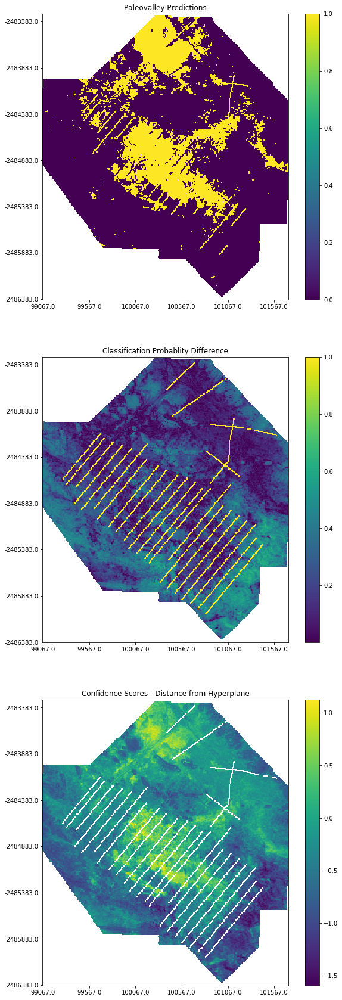

In [198]:
clf = LogisticRegression(solver = 'sag', multi_class = 'multinomial')

clf.fit(train_x,train_y)

# results of predict() are a 1 dimensional numpy array of the same length as the input data
# assign these results to a new column in the dataframe
# predict_ss2 = predict_ss.copy()
def makeXarray(results, add_training_samples = True):
    if len(results.shape) > 1:
        results = results[:,0]
    series = pd.Series(results, index = predict_ss.index)
    td_ss = trainingdata[['x','y']].copy()   # trainingdata subset
    td_ss['new_col'] = np.nan
    td_ss.loc[series.index, 'new_col'] = series
    if isinstance(add_training_samples, bool) and add_training_samples:
        td_ss.loc[train_ss.index, 'new_col'] = train_ss['PV']
    elif not isinstance(add_training_samples, bool):
        td_ss.loc[train_ss.index, 'new_col'] = add_training_samples
        
    # # reshape the data to make it a 2d matrix, not a 1d
    x = td_ss['x'].values.reshape(len(yrange), len(xrange))[0,:]
    y = td_ss['y'].values.reshape(len(yrange), len(xrange))[:,0]
    results = td_ss['new_col'].values.reshape(len(yrange), len(xrange))
    # bring it all together into an xarray
    return xr.DataArray(results, coords = [y,x], dims = ['y','x'])



predicts = makeXarray(clf.predict(predict_ss_vals), True)
probs = makeXarray(clf.predict_proba(predict_ss_vals), 1)
dec_function = makeXarray(clf.decision_function(predict_ss_vals), False)

# plot it up
plt.figure(figsize=[10,30])
plt.subplot(3,1,1)
imshow(predicts)
plt.colorbar()
ax = plt.gca()
ax.set_xticklabels(predicts.x.values)
ax.set_yticklabels(predicts.y.values)
ax.set_title('Paleovalley Predictions')
ax.invert_yaxis()
plt.subplot(3,1,2)
imshow((abs(probs - 0.5))*2) # plotting the difference between the classifications
plt.colorbar()
ax = plt.gca()
ax.set_xticklabels(probs.x.values)
ax.set_yticklabels(probs.y.values)
ax.invert_yaxis()
ax.set_title('Classification Probablity Difference')
plt.subplot(3,1,3)
imshow(dec_function) 
plt.colorbar()
ax = plt.gca()
ax.set_xticklabels(dec_function.x.values)
ax.set_yticklabels(dec_function.y.values)
ax.set_title('Confidence Scores - Distance from Hyperplane')
ax.invert_yaxis()

plt.show()




## Sensitivity Analysis

In [158]:
# build a list of columns/feautres to use for the classification process

# mag has been excluded after the first pass of 
train_features = [col for col in trainingdata.columns if col not in ['PV','mag']]
all_train_features = train_features.copy()
for col in all_train_features:
    if col in ['x','y']:
        continue
    print('starting', col)
    train_features.remove(col)

    # subset the data to non-null rows
    train_ss = trainingdata[trainingdata['PV'].notnull()].dropna(axis = 0, how = 'any', subset = train_features)
    predict_ss = trainingdata[trainingdata['PV'].isnull()].dropna(axis = 0, how = 'any', subset = train_features)[train_features]

    # convert to numpy arrays
    train_x = train_ss[train_features].values
    train_y = train_ss['PV'].values
    predict_ss_vals = predict_ss.values

    # scale and normalize the training data, save the scaler for use with the predicted samples
    scaler = preprocessing.StandardScaler().fit(train_x)
    train_x = scaler.transform(train_x)
    train_x = preprocessing.normalize(train_x)

    # scale and normalize the predictive data so it resembles the training data.
    predict_ss_vals = scaler.transform(predict_ss_vals)
    predict_ss_vals = preprocessing.normalize(predict_ss_vals)
    clf = LogisticRegression(solver = 'sag', multi_class = 'multinomial')

    clf.fit(train_x,train_y)

    # results of predict() are a 1 dimensional numpy array of the same length as the input data
    # assign these results to a new column in the dataframe
    predict_ss2 = predict_ss.copy()

    predict_ss['PV_predicted'] = clf.predict(predict_ss_vals)

    # join the training data back on
    PV = predict_ss[['x','y','PV_predicted']].append(train_ss[['x','y','PV']])
    # fill the PV column with the predicted values
    PV.loc[PV['PV'].isna().index,'PV'] = PV[PV['PV'].isna()]['PV_predicted']
    # drop the now duplicated column
    PV = PV.drop(labels = 'PV_predicted', axis = 1)
    # combine this with the rest of the original data for the area
    results = PV.combine_first(trainingdata[['PV','x','y']])
    # reshape the data to make it a 2d matrix, not a 1d
    x = results['x'].values.reshape(len(yrange), len(xrange))[0,:]
    y = results['y'].values.reshape(len(yrange), len(xrange))[:,0]
    results = results['PV'].values.reshape(len(yrange), len(xrange))
    # bring it all together into an xarray
    results = xr.DataArray(results, coords = [y,x], dims = ['y','x'])

    predict_ss2['pred_conf'] = clf.predict_proba(predict_ss_vals)[:,0]
    conf = predict_ss2[['x','y','pred_conf']].append(train_ss[['x','y','PV']])
    conf.loc[conf['PV'].isna().index,'PV'] = conf[conf['PV'].isna()]['pred_conf']
    conf = conf.drop(labels = 'pred_conf', axis = 1)
    confs = conf.combine_first(trainingdata[['PV','x','y']])
    confs = confs['PV'].values.reshape(len(yrange), len(xrange))
    confs = xr.DataArray(confs, coords = [y,x], dims = ['y','x'])


    # plot it up
    plt.figure(figsize=[20,10])
    plt.subplot(1,2,1)
    imshow(results)
    plt.colorbar()
    ax = plt.gca()
    ax.set_xticklabels(results.x.values)
    ax.set_yticklabels(results.y.values)
    ax.invert_yaxis()
    plt.subplot(1,2,2)
    imshow((abs(confs - 0.5))*2)
    plt.colorbar()
    ax = plt.gca()
    ax.set_xticklabels(results.x.values)
    ax.set_yticklabels(results.y.values)
    ax.invert_yaxis()
    plt.savefig('../sensitivityanalysis/no_mag_' + col + '.png')
    plt.clf()


    # add col back to train_features
    train_features += [col]
    print(col, 'done')

starting th
th done
starting u
u done
starting k
k done
starting grav
grav done
starting elevation
elevation done
starting slope
slope done
starting blue
blue done
starting green
green done
starting red
red done
starting nir
nir done
starting swir1
swir1 done
starting swir2
swir2 done
starting aspect_sin
aspect_sin done
starting aspect_cos
aspect_cos done


<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

## Feature Space Investigations

/g/data/v10/public/modules/dea-env/20180405/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


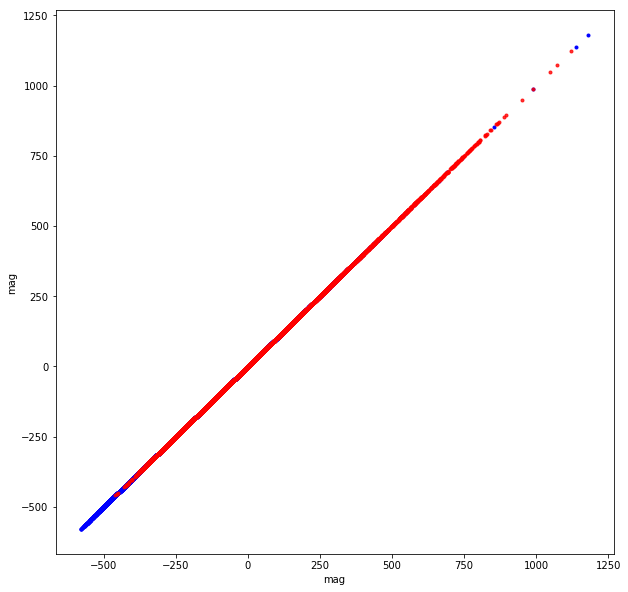

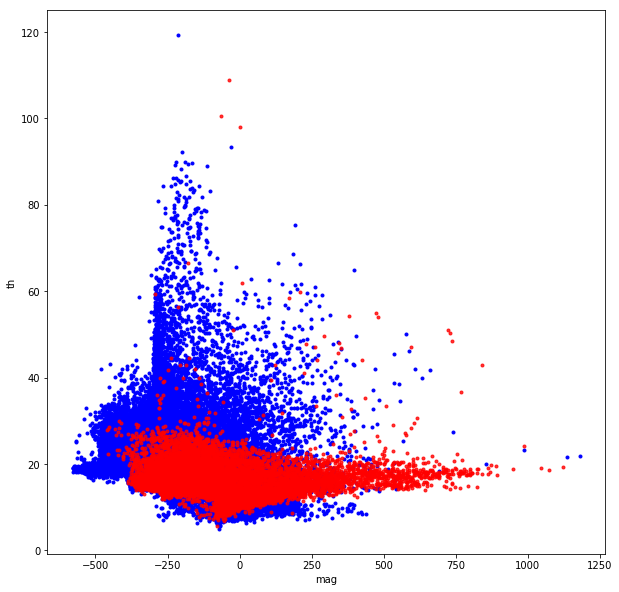

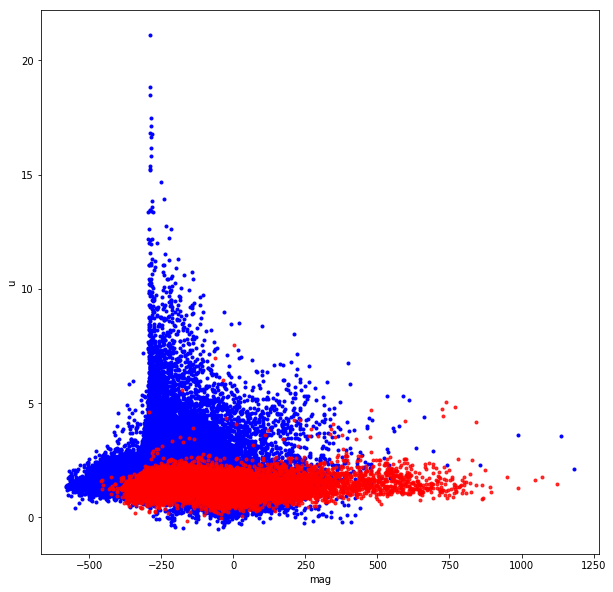

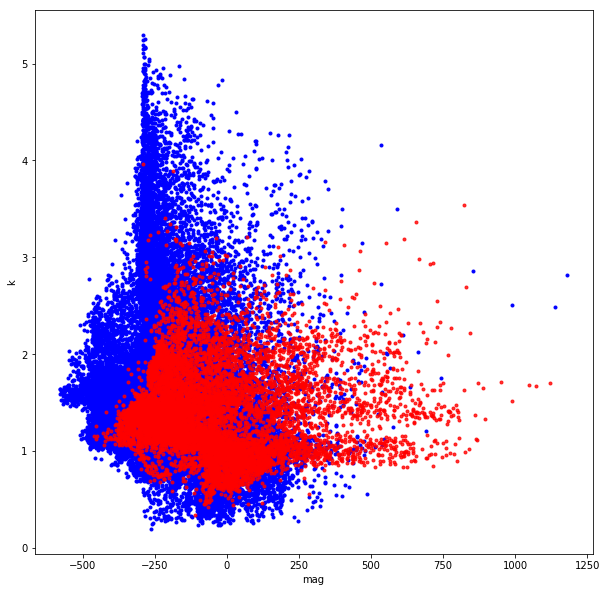

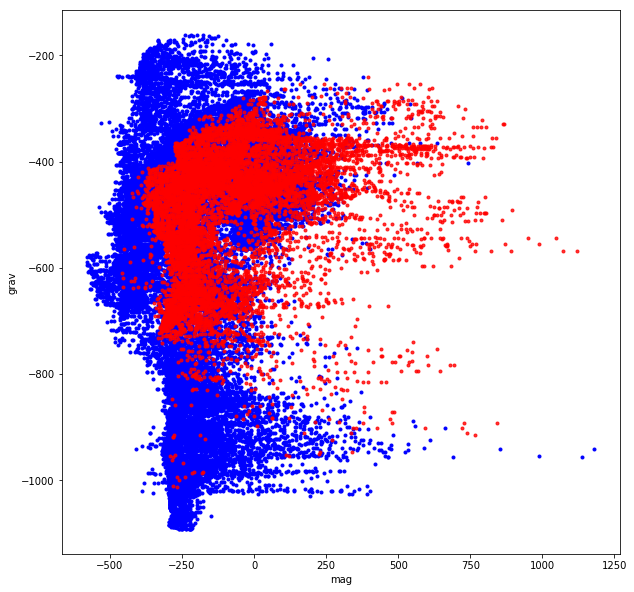

...

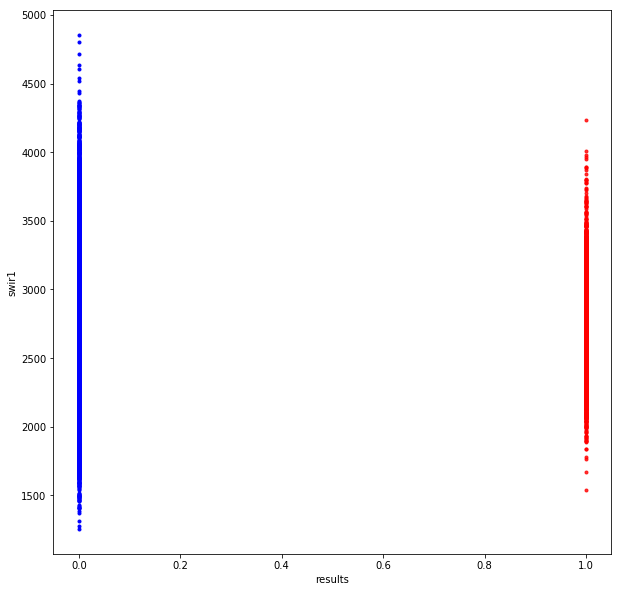

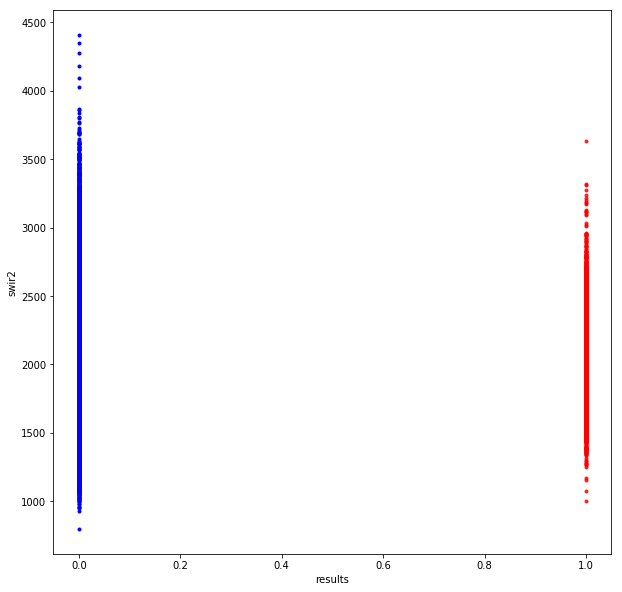

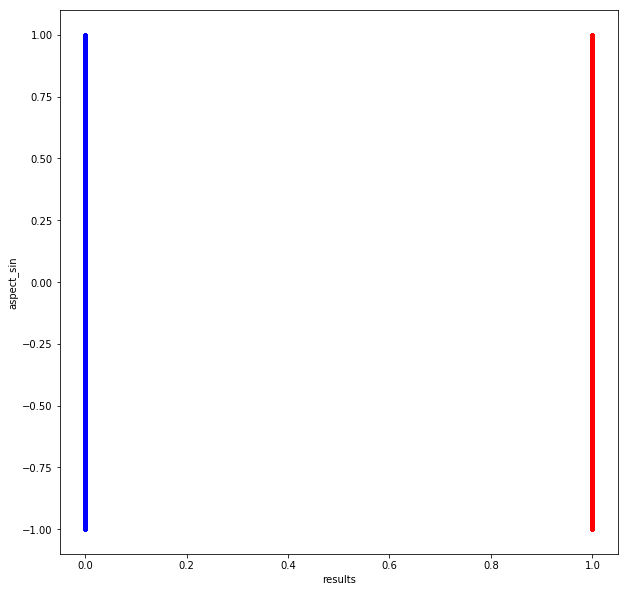

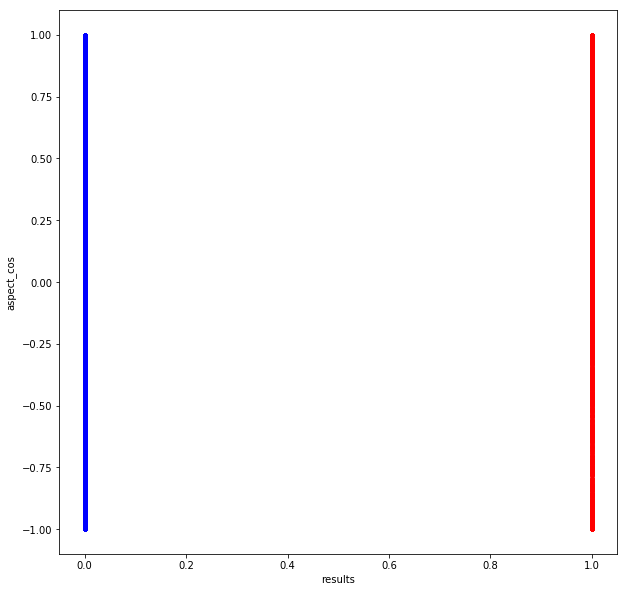

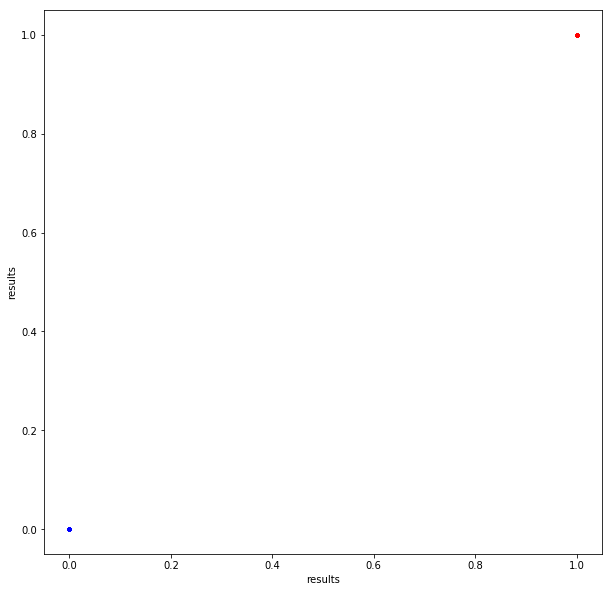

In [226]:
clf = LogisticRegression(solver = 'sag', multi_class = 'multinomial')

clf.fit(train_x,train_y)
series = pd.Series(clf.predict(predict_ss_vals), index = predict_ss.index)    
trainingdata.loc[series.index, 'results'] = series

for c1 in trainingdata.columns:
    for c2 in trainingdata.columns:
        x = c1
        y = c2
        yes_pv = trainingdata[trainingdata['results'] == 1]
        no_pv = trainingdata[trainingdata['results'] == 0]
        plt.figure(figsize=[10,10])
        plt.plot(no_pv[x],no_pv[y], 'b.')
        plt.plot(yes_pv[x],yes_pv[y], 'r.', alpha = 0.8)
        ax = plt.gca()
        ax.set_xlabel(x)
        ax.set_ylabel(y)
        plt.savefig('../crossplots/'+ x + '_' + y + '.png')